Nome: Alexis Duarte Guimarães Mariz

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter, maximum_filter

def generate_checkerboard(img_size: int = 400, squares: int = 8):

    img = np.zeros((img_size, img_size), dtype=np.uint8)
    square_size = img_size // squares

    for y in range(squares):
        for x in range(squares):
            color = 255 if (x + y) % 2 == 0 else 0
            img[y * square_size:(y + 1) * square_size,
                x * square_size:(x + 1) * square_size] = color

    internal_coords = [
        (x * square_size, y * square_size)
        for y in range(1, squares)
        for x in range(1, squares)
    ]
    corners = np.array(internal_coords, dtype=np.float32)

    return img, square_size, corners


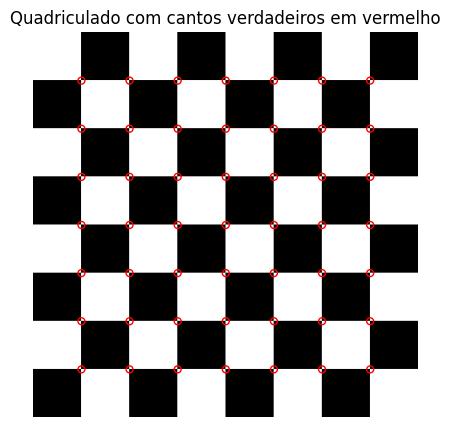

In [2]:
img, square_size, true_corners = generate_checkerboard()
plt.figure(figsize=(5,5))
plt.imshow(img, cmap='gray', vmin=0, vmax=255)
plt.scatter(true_corners[:,0], true_corners[:,1], s=25, marker='o', facecolors='none', edgecolors='red')
plt.title('Quadriculado com cantos verdadeiros em vermelho')
plt.axis('off')
plt.show()

In [3]:
def gradiente(img):
    Ix = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=3)
    Iy = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=3)
    Ix2 = Ix * Ix
    Iy2 = Iy * Iy
    Ixy = Ix * Iy
    return Ix2, Iy2, Ixy

In [4]:
def m(Ix2, Iy2, Ixy, window_size):
    s_Ix2 = gaussian_filter(Ix2, window_size)
    s_Iy2 = gaussian_filter(Iy2, window_size)
    s_Ixy = gaussian_filter(Ixy, window_size)
    return s_Ix2, s_Iy2, s_Ixy

def response(s_Ix2, s_Iy2, s_Ixy, k):
    det = (s_Ix2 * s_Iy2) - (s_Ixy * s_Ixy)
    trace = s_Ix2 + s_Iy2
    return det - (k * trace**2)

In [5]:
def remove_duplicates(corners):
    if len(corners) == 0:
        return corners
    unique_corners = []
    tolerance = 2.5
    for coord in corners:
        # Verifica se já existe um ponto próximo
        is_duplicate = False
        for existing in unique_corners:
            if np.sqrt(np.sum((coord - existing)**2)) < tolerance:
                is_duplicate = True
                break
        
        if not is_duplicate:
            unique_corners.append(coord)
    return np.array(unique_corners)

In [6]:
#Parâmetros originais de Trucco & Verri: threshold e window_size_gaussian
def harris(img, window_size_gaussian=3, k=0.04, threshold_ratio=0.1, window_size_nms=7):
    Ix2, Iy2, Ixy = gradiente(img)
    s_Ix2, s_Iy2, s_Ixy = m(Ix2, Iy2, Ixy, window_size_gaussian)
    r = response(s_Ix2, s_Iy2, s_Ixy, k)
    threshold = r.max() * threshold_ratio
    r_threshold = (r > threshold)
    #Non-max supression:
    maximos_locais = (maximum_filter(r,size=window_size_nms,mode='constant',cval=-np.inf) == r)
    corners = r_threshold & maximos_locais
    detected_corners = np.argwhere(corners)
    detected_corners = remove_duplicates(detected_corners)
    return detected_corners

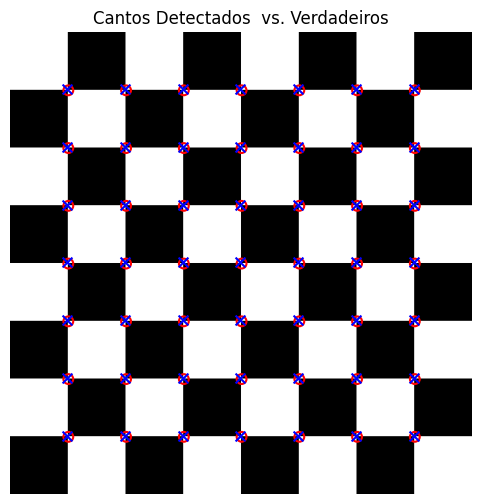

In [7]:
detected_corners = harris(img)
plt.figure(figsize=(6,6))
plt.imshow(img, cmap='gray')
plt.title(f'Cantos Detectados  vs. Verdadeiros')
plt.axis('off')
plt.scatter(true_corners[:,0], true_corners[:,1], s=50, marker='o', 
            facecolors='none', edgecolors='red', linewidths=1.5, label='Verdadeiros')
#argwhere retorna (linha, coluna), então para scatter é (coluna, linha)
plt.scatter(detected_corners[:,1], detected_corners[:,0], s=50, marker='x', 
            c='blue', linewidths=1.5, label='Harris Detectados')

A imagem acima mostra que o algoritmo detectou corretamente todos os cantos para a imagem gerada sinteticamente sem ruído.

In [8]:
def adiciona_ruido(img, sigma):
    noise = np.random.normal(0, sigma, img.shape)
    noisy_img = img.astype(np.float64) + noise
    noisy_img = np.clip(noisy_img, 0, 255)
    noisy_img = noisy_img.astype(np.uint8)
    return noisy_img

In [9]:
from scipy.spatial.distance import cdist
def metricas(detected_corners,true_corners):
    if len(detected_corners) == 0:
        return 0.0, 0, len(true_corners)
    
    if len(true_corners) == 0:
        return 0.0, len(detected_corners), 0
    true_corners = np.array([[c[1], c[0]] for c in true_corners]) #inverte linhas e colunas

    distances = cdist(true_corners, detected_corners)
    min_distances = np.min(distances, axis=1)
    closest_detected = np.argmin(distances, axis=1)
    rms = np.sqrt(np.mean(min_distances**2))
    valid_matches = min_distances < 5.0
    matched_detected = set(closest_detected[valid_matches])
    missed = np.sum(~valid_matches)
    spurious = len(detected_corners) - len(matched_detected)

    return rms, spurious, missed

In [10]:
detected_corners = harris(img)
rms,spurious,missed = metricas(detected_corners,true_corners)
print(f"RMS: {rms}")
print(f"Spurious: {spurious}")
print(f"Missed: {missed}")


RMS: 1.4142135623730951
Spurious: 0
Missed: 0


In [11]:
def analise():
#Parâmetros da implementação de Trucco & Verri: threshold e window_size_gaussian
    params = [
        {'window_size_gaussian': 3, 'threshold_ratio': 0.1},
        {'window_size_gaussian': 3, 'threshold_ratio': 0.15},
        {'window_size_gaussian': 3, 'threshold_ratio': 0.2},
        {'window_size_gaussian': 5, 'threshold_ratio': 0.1},
        {'window_size_gaussian': 5, 'threshold_ratio': 0.15},
        {'window_size_gaussian': 5, 'threshold_ratio': 0.2},
        {'window_size_gaussian': 7, 'threshold_ratio': 0.1},
        {'window_size_gaussian': 7, 'threshold_ratio': 0.15},
        {'window_size_gaussian': 7, 'threshold_ratio': 0.2},
        {'window_size_gaussian': 9, 'threshold_ratio': 0.1},
        {'window_size_gaussian': 9, 'threshold_ratio': 0.15},
        {'window_size_gaussian': 9, 'threshold_ratio': 0.2},
    ]
    noise_levels = [0, 10, 25, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500, 1000]
    results = {}

    for i, param_set in enumerate(params):
            print(f"Testando conjunto de parâmetros {i+1}: {param_set}")
            
            rms_means = []
            rms_stds = []
            missed_means = []
            missed_stds = []
            spurious_means = []
            spurious_stds = []
            
            for sigma in noise_levels:
                print(f"  Sigma = {sigma:.1f}")
                
                rms_values = []
                missed_values = []
                spurious_values = []
                
                for rep in range(10):
                    # Gera imagem limpa
                    img_clean, _, true_corners = generate_checkerboard()
                    
                    # Adiciona ruído
                    if sigma > 0:
                        img_noisy = adiciona_ruido(img_clean, sigma)
                    else:
                        img_noisy = img_clean
                    
                    # Detecta cantos
                    detected_corners = harris(img_noisy, **param_set)
                    
                    # Calcula métricas
                    rms, spurious, missed = metricas(detected_corners,true_corners)
                    
                    rms_values.append(rms)
                    missed_values.append(missed)
                    spurious_values.append(spurious)
                
                # Calcula estatísticas
                rms_means.append(np.mean(rms_values))
                rms_stds.append(np.std(rms_values))
                missed_means.append(np.mean(missed_values))
                missed_stds.append(np.std(missed_values))
                spurious_means.append(np.mean(spurious_values))
                spurious_stds.append(np.std(spurious_values))
            
            results[f'gaussian_{param_set["window_size_gaussian"]}_thresh_{param_set["threshold_ratio"]}'] = {
                'parameters': param_set,
                'noise_levels': noise_levels,
                'rms_means': np.array(rms_means),
                'rms_stds': np.array(rms_stds),
                'missed_means': np.array(missed_means),
                'missed_stds': np.array(missed_stds),
                'spurious_means': np.array(spurious_means),
                'spurious_stds': np.array(spurious_stds)
            }
    return results

In [12]:
def plot_analise(results):
    fig, axes = plt.subplots(2, 2, figsize=(15, 12))
    n_params = len(results)
    colors = plt.cm.tab10(np.linspace(0, 1, n_params))

    # RMS Distance
    ax = axes[0, 0]
    for i, (key, data) in enumerate(results.items()):
        # Trunca valores infinitos para visualização
        rms_means = np.where(data['rms_means'] == np.inf, 100, data['rms_means'])
        rms_stds = np.where(data['rms_stds'] == np.inf, 0, data['rms_stds'])

        ax.errorbar(data['noise_levels'], rms_means, yerr=rms_stds,
                label=f"Parâmetros {i+1}", color=colors[i], marker='o')
    ax.set_xlabel('Sigma do Ruído Gaussiano')
    ax.set_ylabel('Distância RMS (pixels)')
    ax.set_title('Distância RMS vs Nível de Ruído')
    ax.legend()
    ax.grid(True)

    # Missed Corners
    ax = axes[0, 1]
    for i, (key, data) in enumerate(results.items()):
        ax.errorbar(data['noise_levels'], data['missed_means'], yerr=data['missed_stds'],
                label=f"Parâmetros {i+1}", color=colors[i], marker='s')
    ax.set_xlabel('Sigma do Ruído Gaussiano')
    ax.set_ylabel('Cantos Perdidos')
    ax.set_title('Cantos Perdidos vs Nível de Ruído')
    ax.legend()
    ax.grid(True)

    # Spurious Corners
    ax = axes[1, 0]
    for i, (key, data) in enumerate(results.items()):
        ax.errorbar(data['noise_levels'], data['spurious_means'], yerr=data['spurious_stds'],
                label=f"Parâmetros {i+1}", color=colors[i], marker='^')
    ax.set_xlabel('Sigma do Ruído Gaussiano')
    ax.set_ylabel('Cantos Espúrios')
    ax.set_title('Cantos Espúrios vs Nível de Ruído')
    ax.legend()
    ax.grid(True)

    plt.tight_layout()
    plt.savefig('harris_robustness_analysis.png', dpi=300, bbox_inches='tight')
    plt.show()

def analise_opencv():
    params = [
        {'window_size_gaussian': 3, 'threshold_ratio': 0.1},
        {'window_size_gaussian': 3, 'threshold_ratio': 0.15},
        {'window_size_gaussian': 3, 'threshold_ratio': 0.2},
        {'window_size_gaussian': 5, 'threshold_ratio': 0.1},
        {'window_size_gaussian': 5, 'threshold_ratio': 0.15},
        {'window_size_gaussian': 5, 'threshold_ratio': 0.2},
        {'window_size_gaussian': 7, 'threshold_ratio': 0.1},
        {'window_size_gaussian': 7, 'threshold_ratio': 0.15},
        {'window_size_gaussian': 7, 'threshold_ratio': 0.2},
        {'window_size_gaussian': 9, 'threshold_ratio': 0.1},
        {'window_size_gaussian': 9, 'threshold_ratio': 0.15},
        {'window_size_gaussian': 9, 'threshold_ratio': 0.2},
    ]
    noise_levels = [0, 10, 25, 50, 100, 150, 200, 250, 300, 350, 400, 450, 500, 1000]
    
    results = {}

    for param_set in params:
        key = f"w{param_set['window_size_gaussian']}_th{param_set['threshold_ratio']}"
        print(f"== OpenCV: parâmetros {key} ==")

        rms_means     = []
        rms_stds      = []
        missed_means  = []
        missed_stds   = []
        spurious_means= []
        spurious_stds = []

        for sigma in noise_levels:
            rms_vals      = []
            missed_vals   = []
            spurious_vals = []
            print(f" Sigma = {sigma}")

            for _ in range(10):
                img_clean, _, true_corners = generate_checkerboard()
                img_noisy = adiciona_ruido(img_clean, sigma) if sigma>0 else img_clean

                gray = np.float32(img_noisy)
                dst = cv2.cornerHarris(
                    gray,
                    blockSize=param_set['window_size_gaussian'],
                    ksize=3,
                    k=0.04
                )
                dst = cv2.dilate(dst, None)
                thresh = param_set['threshold_ratio'] * dst.max()
                pts = np.argwhere(dst > thresh)
                cv_corners = [tuple(pt[::-1]) for pt in pts]

                rms, spurious, missed = metricas(cv_corners, true_corners)
                rms_vals.append(rms)
                missed_vals.append(missed)
                spurious_vals.append(spurious)

            rms_means.append(np.mean(rms_vals))
            rms_stds.append( np.std(rms_vals))
            missed_means.append(np.mean(missed_vals))
            missed_stds.append( np.std(missed_vals))
            spurious_means.append(np.mean(spurious_vals))
            spurious_stds.append( np.std(spurious_vals))

        results[key] = {
            'parameters':     param_set,
            'noise_levels':   noise_levels,
            'rms_means':      np.array(rms_means),
            'rms_stds':       np.array(rms_stds),
            'missed_means':   np.array(missed_means),
            'missed_stds':    np.array(missed_stds),
            'spurious_means': np.array(spurious_means),
            'spurious_stds':  np.array(spurious_stds),
        }

    return results


Testando conjunto de parâmetros 1: {'window_size_gaussian': 3, 'threshold_ratio': 0.1}
  Sigma = 0.0
  Sigma = 10.0
  Sigma = 25.0
  Sigma = 50.0
  Sigma = 100.0
  Sigma = 150.0
  Sigma = 200.0
  Sigma = 250.0
  Sigma = 300.0
  Sigma = 350.0
  Sigma = 400.0
  Sigma = 450.0
  Sigma = 500.0
  Sigma = 1000.0
Testando conjunto de parâmetros 2: {'window_size_gaussian': 3, 'threshold_ratio': 0.15}
  Sigma = 0.0
  Sigma = 10.0
  Sigma = 25.0
  Sigma = 50.0
  Sigma = 100.0
  Sigma = 150.0
  Sigma = 200.0
  Sigma = 250.0
  Sigma = 300.0
  Sigma = 350.0
  Sigma = 400.0
  Sigma = 450.0
  Sigma = 500.0
  Sigma = 1000.0
Testando conjunto de parâmetros 3: {'window_size_gaussian': 3, 'threshold_ratio': 0.2}
  Sigma = 0.0
  Sigma = 10.0
  Sigma = 25.0
  Sigma = 50.0
  Sigma = 100.0
  Sigma = 150.0
  Sigma = 200.0
  Sigma = 250.0
  Sigma = 300.0
  Sigma = 350.0
  Sigma = 400.0
  Sigma = 450.0
  Sigma = 500.0
  Sigma = 1000.0
Testando conjunto de parâmetros 4: {'window_size_gaussian': 5, 'threshold_rati

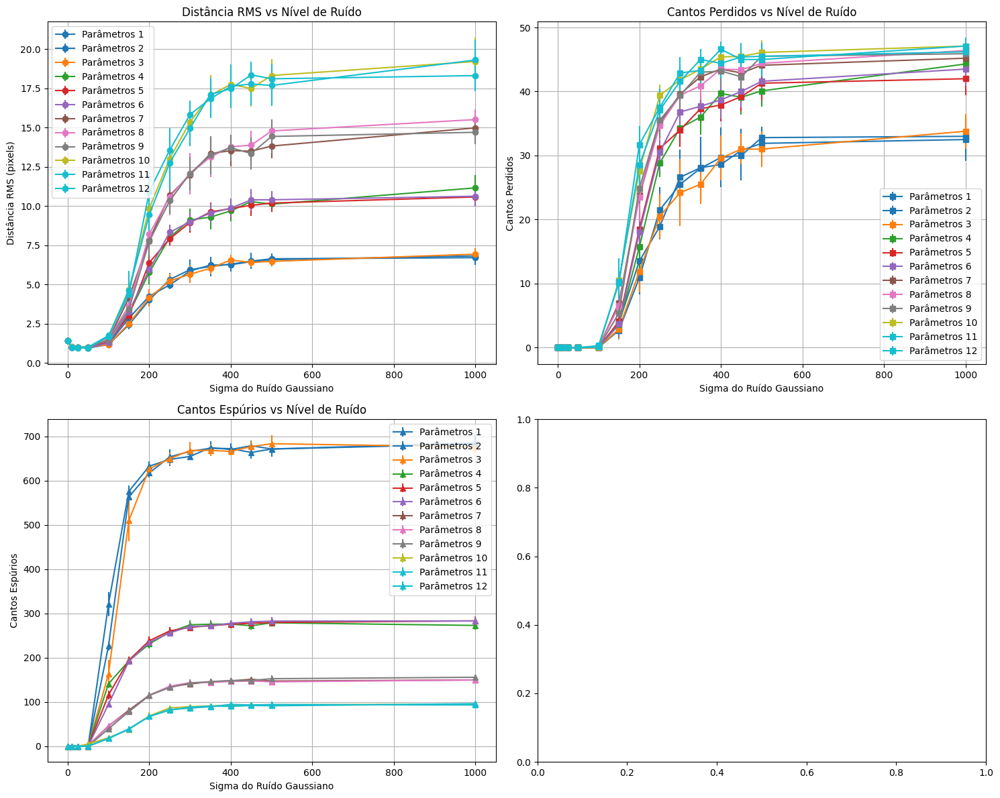

openCV:
== OpenCV: parâmetros w3_th0.1 ==
 Sigma = 0
 Sigma = 10
 Sigma = 25
 Sigma = 50
 Sigma = 100
 Sigma = 150
 Sigma = 200
 Sigma = 250
 Sigma = 300
 Sigma = 350
 Sigma = 400
 Sigma = 450
 Sigma = 500
 Sigma = 1000
== OpenCV: parâmetros w3_th0.15 ==
 Sigma = 0
 Sigma = 10
 Sigma = 25
 Sigma = 50
 Sigma = 100
 Sigma = 150
 Sigma = 200
 Sigma = 250
 Sigma = 300
 Sigma = 350
 Sigma = 400
 Sigma = 450
 Sigma = 500
 Sigma = 1000
== OpenCV: parâmetros w3_th0.2 ==
 Sigma = 0
 Sigma = 10
 Sigma = 25
 Sigma = 50
 Sigma = 100
 Sigma = 150
 Sigma = 200
 Sigma = 250
 Sigma = 300
 Sigma = 350
 Sigma = 400
 Sigma = 450
 Sigma = 500
 Sigma = 1000
== OpenCV: parâmetros w5_th0.1 ==
 Sigma = 0
 Sigma = 10
 Sigma = 25
 Sigma = 50
 Sigma = 100
 Sigma = 150
 Sigma = 200
 Sigma = 250
 Sigma = 300
 Sigma = 350
 Sigma = 400
 Sigma = 450
 Sigma = 500
 Sigma = 1000
== OpenCV: parâmetros w5_th0.15 ==
 Sigma = 0
 Sigma = 10
 Sigma = 25
 Sigma = 50
 Sigma = 100
 Sigma = 150
 Sigma = 200
 Sigma = 250
 Sigma = 

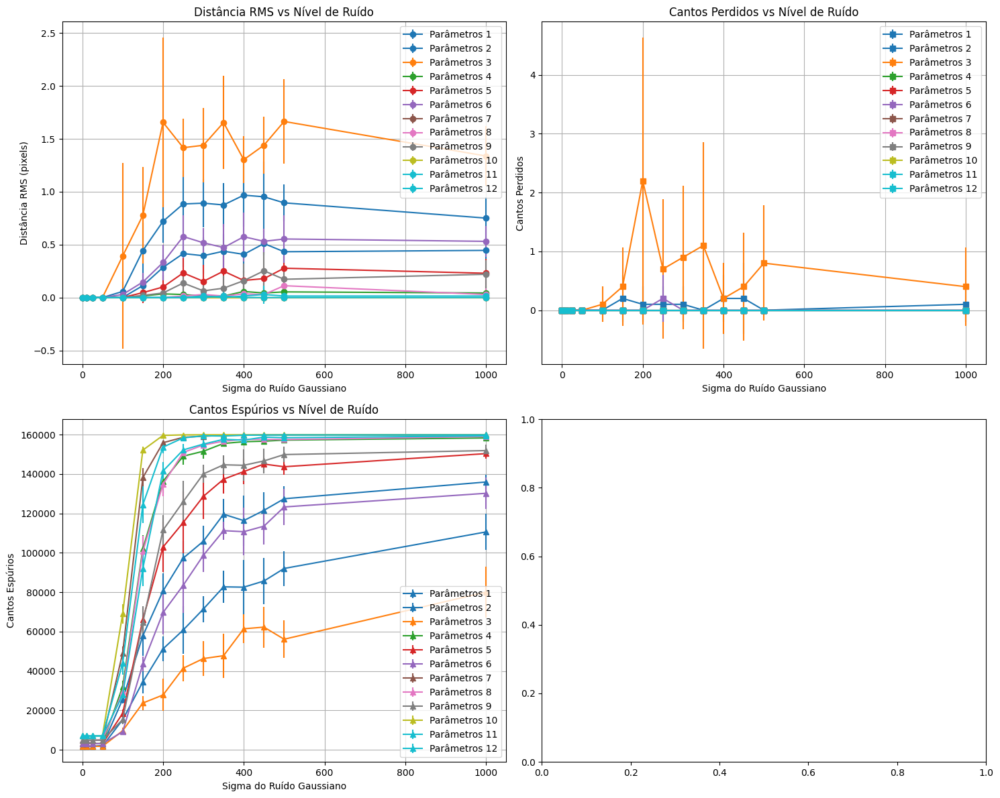

In [13]:
results = analise()
plot_analise(results)
print("openCV:")
results_opencv = analise_opencv()
plot_analise(results_opencv)

Os gráficos acima apresentam o RMS, os cantos não detectados e os cantos espúrios para cada conjunto de parâmetros, para cada nível de ruído.

In [14]:
def visualiza_ruido(sigma=25, params=None):
    if params is None:
        params = {'window_size_gaussian': 3, 'k': 0.04, 'threshold_ratio': 0.1, 'window_size_nms': 3}

    img_clean, square_size, true_corners = generate_checkerboard()

    np.random.seed(42)  # Para reprodutibilidade
    img_noisy = adiciona_ruido(img_clean, sigma)

    detected_corners = harris(img_noisy, **params)
    rms_dist, missed, spurious = metricas(true_corners, detected_corners)
    fig, axes = plt.subplots(1, 3, figsize=(18, 6))
    
    # Imagem original
    axes[0].imshow(img_clean, cmap='gray', vmin=0, vmax=255)
    axes[0].scatter(true_corners[:, 0], true_corners[:, 1], 
                   s=50, marker='o', facecolors='none', 
                   edgecolors='red', linewidths=2)
    axes[0].set_title(f'Imagem Original\n{len(true_corners)} cantos verdadeiros')
    axes[0].axis('off')
    
    # Imagem com ruído
    axes[1].imshow(img_noisy, cmap='gray', vmin=0, vmax=255)
    axes[1].set_title(f'Imagem com Ruído (σ={sigma})')
    axes[1].axis('off')
    
    # Imagem com detecção
    axes[2].imshow(img_noisy, cmap='gray', vmin=0, vmax=255)
    axes[2].scatter(true_corners[:, 0], true_corners[:, 1], 
                   s=50, marker='o', facecolors='none', 
                   edgecolors='red', linewidths=2, label=f'Verdadeiros ({len(true_corners)})')
    
    if len(detected_corners) > 0:
        axes[2].scatter(detected_corners[:, 1], detected_corners[:, 0], 
                       s=50, marker='x', c='blue', linewidths=2, 
                       label=f'Detectados ({len(detected_corners)})')
    
    rms_str = f'{rms_dist:.1f}' if rms_dist != float('inf') else '∞'
    axes[2].set_title(f'Detecção Harris\nRMS={rms_str}, Perdidos={missed}, Espúrios={spurious}')
    #axes[2].legend()
    #axes[2].axis('off')
    
    plt.tight_layout()
    plt.show()

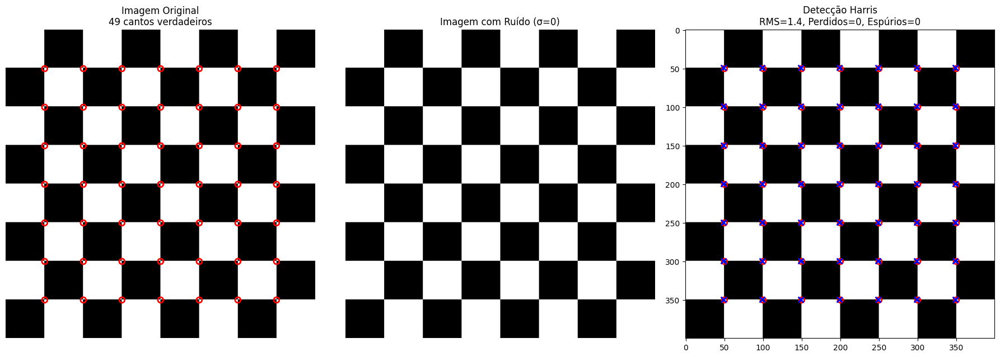

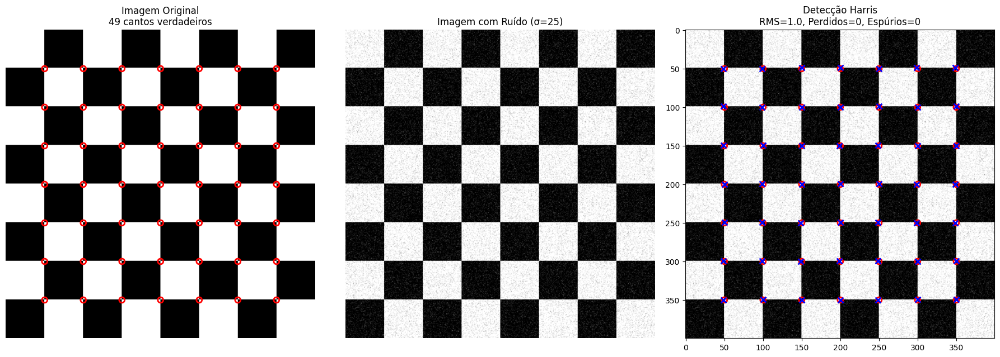

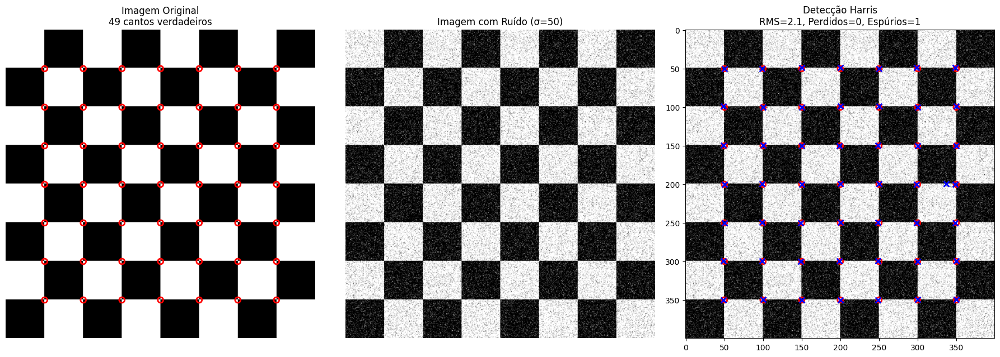

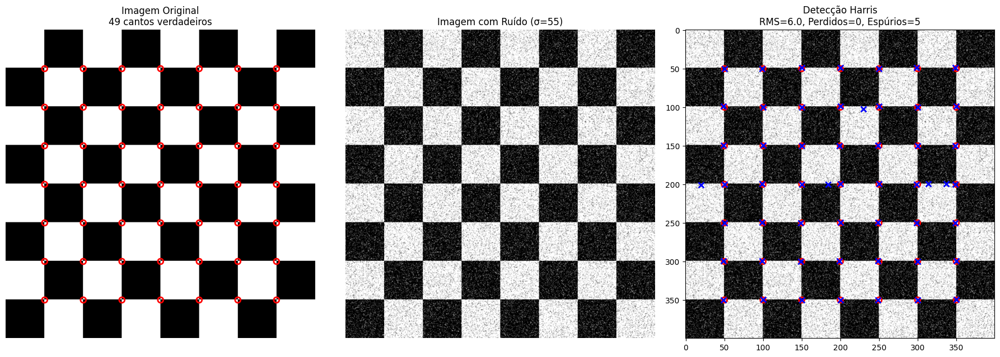

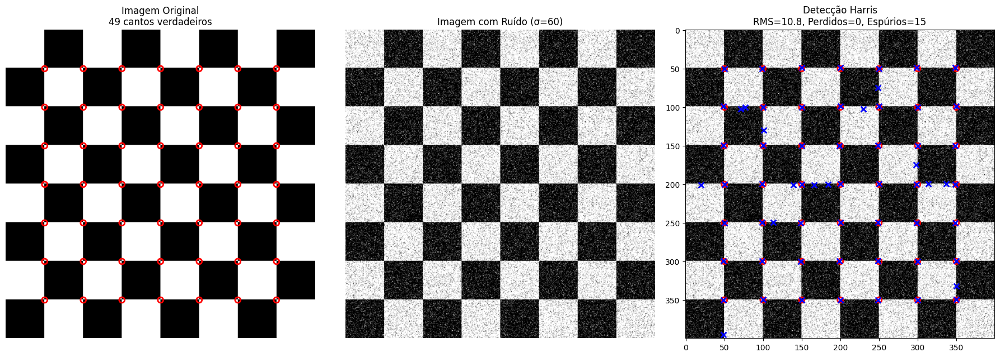

...

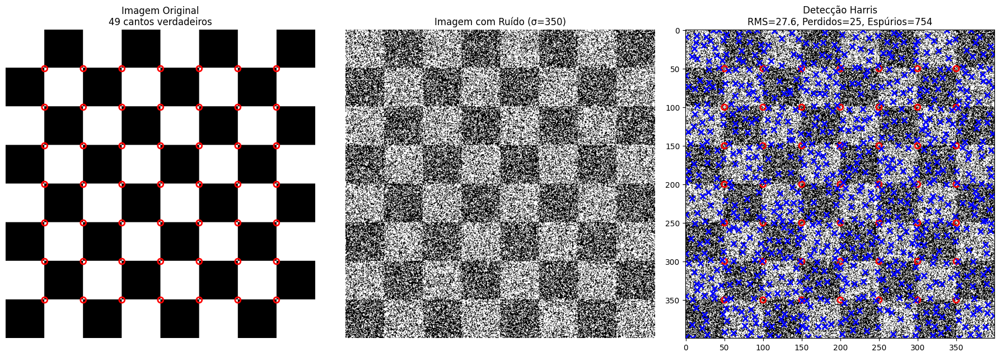

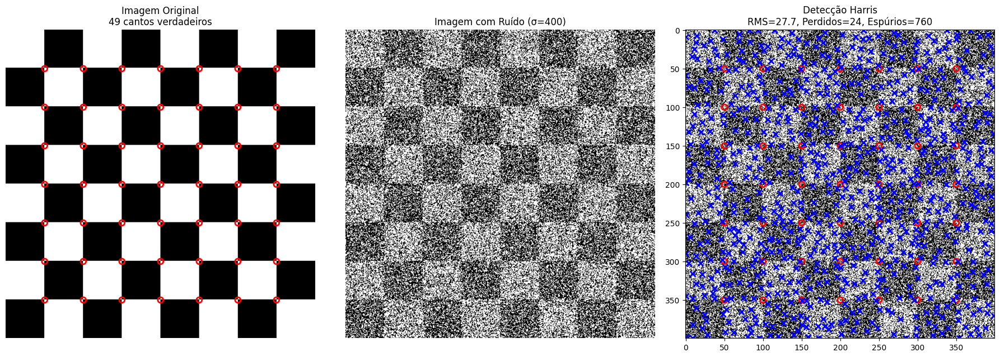

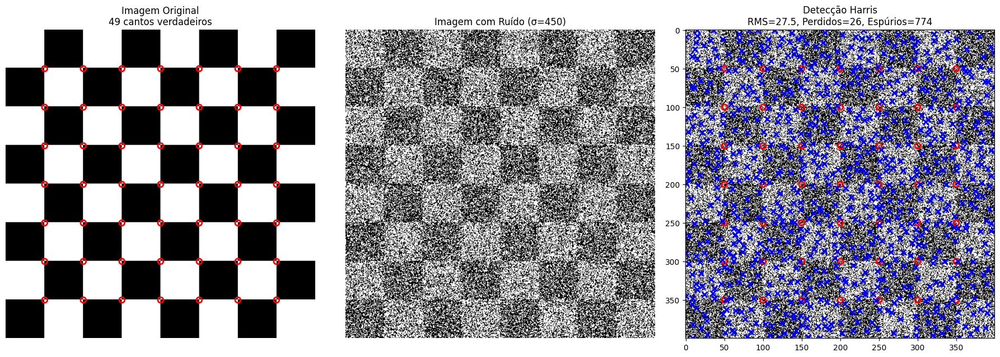

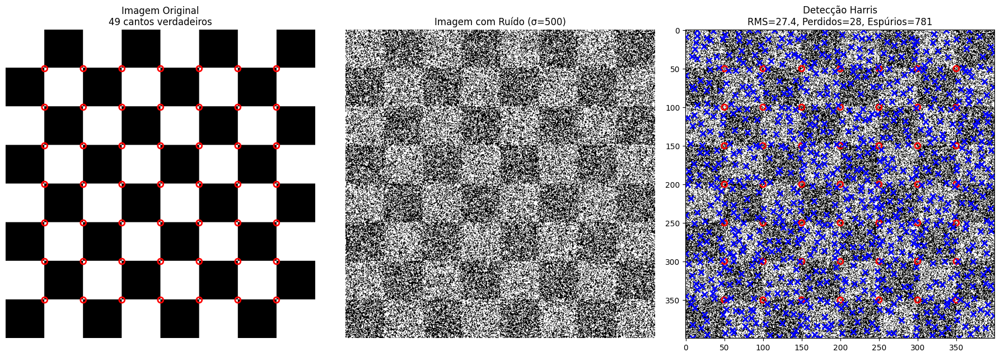

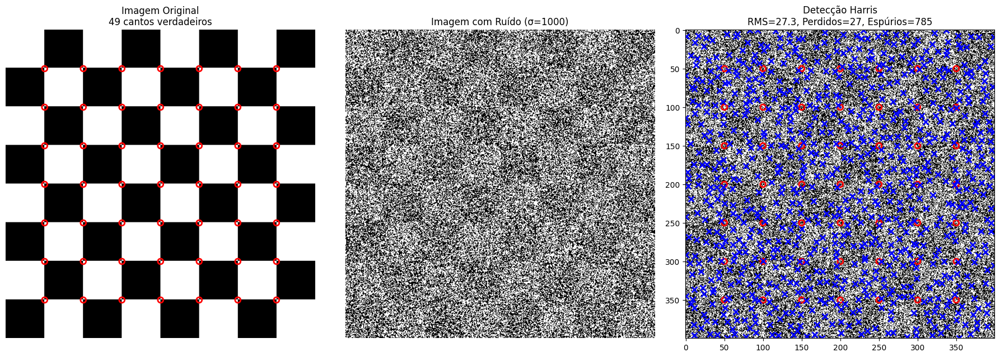

In [15]:
# Teste com diferentes níveis de ruído
visualiza_ruido(sigma=0)
visualiza_ruido(sigma=25)
visualiza_ruido(sigma=50)
visualiza_ruido(sigma=55)
visualiza_ruido(sigma=60)
visualiza_ruido(sigma=65)
visualiza_ruido(sigma=70)
visualiza_ruido(sigma=75)
visualiza_ruido(sigma=100)
visualiza_ruido(sigma=150)
visualiza_ruido(sigma=200)
visualiza_ruido(sigma=250)
visualiza_ruido(sigma=300)
visualiza_ruido(sigma=350)
visualiza_ruido(sigma=400)
visualiza_ruido(sigma=450)
visualiza_ruido(sigma=500)
visualiza_ruido(sigma=1000)
